## 05 - Inference Visualization & Error Analysis

This notebook provides detailed inference visualization and error analysis for all three trained models:
1. **Baseline CNN (Improved)** - Custom architecture trained from scratch
2. **ResNet50** - Transfer learning with two-phase training
3. **EfficientNet-B3** - Efficient architecture with compound scaling

### Contents
1. Setup and Imports
2. Configuration
3. Load Models
4. Prepare DataLoaders
5. Inference Visualization
6. Error Analysis - Misclassified Examples
7. Error Analysis - Confusion Patterns
8. Error Analysis - Per-Class Performance
9. Error Analysis - Confidence Analysis
10. Model Comparison on Failure Cases
11. Summary

---

**Note:** This notebook analyzes model predictions and errors for visual inspection and understanding.

In [1]:
# Setup: Add project root to Python path
import sys
from pathlib import Path

# Try multiple strategies to find the project root
notebook_dir = Path().resolve()
project_root = None

# Strategy 1: If we're in notebooks/, parent is project root
if notebook_dir.name == 'notebooks' and (notebook_dir.parent / 'src').exists():
    project_root = notebook_dir.parent
# Strategy 2: Check if current directory is project root
elif (notebook_dir / 'src').exists():
    project_root = notebook_dir
# Strategy 3: Check parent directory
elif (notebook_dir.parent / 'src').exists():
    project_root = notebook_dir.parent
# Strategy 4: Walk up directory tree to find src
else:
    current = notebook_dir
    while current != current.parent:
        if (current / 'src').exists():
            project_root = current
            break
        current = current.parent

if project_root:
    if str(project_root) not in sys.path:
        sys.path.insert(0, str(project_root))
    print(f"✓ Project root found: {project_root}")
else:
    print("⚠ Warning: Could not find project root. Trying default path...")
    # Fallback: assume parent if in notebooks/
    if notebook_dir.name == 'notebooks':
        fallback = notebook_dir.parent
    else:
        fallback = notebook_dir
    if str(fallback) not in sys.path:
        sys.path.insert(0, str(fallback))
    print(f"✓ Using fallback path: {fallback}")

✓ Project root found: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification


In [2]:
# Import Libraries
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
from pathlib import Path
from PIL import Image
import time
import warnings
from collections import Counter, defaultdict
warnings.filterwarnings('ignore')

# PyTorch
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import DataLoader
import torchvision.transforms as transforms

# Evaluation
from sklearn.metrics import (
    confusion_matrix, classification_report,
    precision_recall_fscore_support
)
from sklearn.preprocessing import label_binarize

# Dataset and transforms
from src.data.dataset import FlowerDataset
from src.data.augmentation import get_val_transforms, AlbumentationsTransform

# Models
from src.models.baseline_cnn import BaselineCNN
from src.models.resnet_model import ResNetClassifier
from src.models.efficientnet_model import EfficientNetClassifier

# Evaluation utilities
from src.evaluation.metrics import get_predictions, analyze_errors

# Set style for plots
plt.style.use('seaborn-v0_8-whitegrid')
plt.rcParams['figure.figsize'] = (14, 8)
plt.rcParams['font.size'] = 11
sns.set_palette("husl")

# Configuration
notebook_dir = Path().resolve()
if notebook_dir.name == 'notebooks':
    PROJECT_ROOT = notebook_dir.parent
else:
    PROJECT_ROOT = notebook_dir

DATA_DIR = PROJECT_ROOT / 'data/raw/oxford_flowers_102'
OUTPUT_DIR = PROJECT_ROOT / 'results/evaluation'
MODELS_DIR = PROJECT_ROOT / 'results/models'
FIGURES_DIR = PROJECT_ROOT / 'results/figures'

# Create output directories
OUTPUT_DIR.mkdir(parents=True, exist_ok=True)
FIGURES_DIR.mkdir(parents=True, exist_ok=True)

# Model paths
BASELINE_MODEL_PATH = MODELS_DIR / 'baseline_cnn_improved_no_masks_best.pth'
RESNET50_MODEL_PATH = MODELS_DIR / 'resnet50_best.pth'
EFFICIENTNET_MODEL_PATH = MODELS_DIR / 'efficientnet_b3_best.pth'

# Evaluation parameters
BATCH_SIZE = 32
NUM_WORKERS = 4
NUM_CLASSES = 102

# Device configuration
device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f"✓ Using device: {device}")
if device == 'cuda':
    print(f"✓ GPU: {torch.cuda.get_device_name(0)}")
    
print(f"✓ Project root: {PROJECT_ROOT}")
print(f"✓ Data directory: {DATA_DIR}")
print(f"✓ Models directory: {MODELS_DIR}")
print(f"✓ Output directory: {OUTPUT_DIR}")

✓ Using device: cuda
✓ GPU: NVIDIA GeForce RTX 2050
✓ Project root: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification
✓ Data directory: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\data\raw\oxford_flowers_102
✓ Models directory: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\models
✓ Output directory: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\evaluation


## 3. Load Models

Load all three trained models for inference and error analysis.

In [3]:
# Load Baseline CNN
print("Loading Baseline CNN model...")
baseline_model = None
if BASELINE_MODEL_PATH.exists():
    try:
        checkpoint = torch.load(BASELINE_MODEL_PATH, map_location=device, weights_only=False)
        baseline_model = BaselineCNN(num_classes=NUM_CLASSES, dropout=0.5, improved=True)
        baseline_model.load_state_dict(checkpoint['model_state_dict'])
        baseline_model.to(device)
        baseline_model.eval()
        print(f"✓ Baseline CNN loaded successfully")
    except Exception as e:
        print(f"⚠ Error loading Baseline CNN: {e}")
        baseline_model = None
else:
    print(f"⚠ Baseline CNN model not found at {BASELINE_MODEL_PATH}")

# Load ResNet50
print("\nLoading ResNet50 model...")
resnet50_model = None
if RESNET50_MODEL_PATH.exists():
    try:
        checkpoint = torch.load(RESNET50_MODEL_PATH, map_location=device, weights_only=False)
        resnet50_model = ResNetClassifier(num_classes=NUM_CLASSES, pretrained=True, dropout=0.3, freeze_backbone=False)
        resnet50_model.load_state_dict(checkpoint['model_state_dict'])
        resnet50_model.to(device)
        resnet50_model.eval()
        print(f"✓ ResNet50 loaded successfully")
    except Exception as e:
        print(f"⚠ Error loading ResNet50: {e}")
        resnet50_model = None
else:
    print(f"⚠ ResNet50 model not found at {RESNET50_MODEL_PATH}")

# Load EfficientNet-B3
print("\nLoading EfficientNet-B3 model...")
efficientnet_model = None
if EFFICIENTNET_MODEL_PATH.exists():
    try:
        checkpoint = torch.load(EFFICIENTNET_MODEL_PATH, map_location=device, weights_only=False)
        efficientnet_model = EfficientNetClassifier(
            num_classes=NUM_CLASSES, 
            model_name='efficientnet_b3',
            pretrained=True, 
            dropout=0.3,
            freeze_backbone=False
        )
        efficientnet_model.load_state_dict(checkpoint['model_state_dict'])
        efficientnet_model.to(device)
        efficientnet_model.eval()
        print(f"✓ EfficientNet-B3 loaded successfully")
    except Exception as e:
        print(f"⚠ Error loading EfficientNet-B3: {e}")
        efficientnet_model = None
else:
    print(f"⚠ EfficientNet-B3 model not found at {EFFICIENTNET_MODEL_PATH}")

Loading Baseline CNN model...
✓ Baseline CNN loaded successfully

Loading ResNet50 model...
Loaded ResNet50 with ImageNet pre-trained weights
✓ ResNet50 loaded successfully

Loading EfficientNet-B3 model...
Loaded efficientnet_b3 with ImageNet pre-trained weights
Backbone output features: 1536
✓ EfficientNet-B3 loaded successfully


## 4. Prepare DataLoaders

Create test DataLoaders for inference visualization and error analysis.

In [4]:
# Create test DataLoader for Baseline CNN and ResNet50 (224x224)
print("Creating test DataLoader for Baseline CNN and ResNet50 (224x224)...")
if DATA_DIR.exists():
    val_transform_224 = get_val_transforms(image_size=224, use_albumentations=True)
    val_transform_wrapper_224 = AlbumentationsTransform(val_transform_224)
    
    test_dataset_224 = FlowerDataset(
        root_dir=str(DATA_DIR),
        split='test',
        transform=val_transform_wrapper_224
    )
    
    test_loader_224 = DataLoader(
        test_dataset_224,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=NUM_WORKERS,
        pin_memory=True if torch.cuda.is_available() else False
    )
    
    print(f"✓ Test dataset (224x224) created")
    print(f"  Test samples: {len(test_dataset_224):,}")
else:
    print(f"⚠ Data directory not found at {DATA_DIR}")
    test_dataset_224 = None
    test_loader_224 = None

# Create test DataLoader for EfficientNet-B3 (300x300)
print("\nCreating test DataLoader for EfficientNet-B3 (300x300)...")
if DATA_DIR.exists():
    val_transform_300 = get_val_transforms(image_size=300, use_albumentations=True)
    val_transform_wrapper_300 = AlbumentationsTransform(val_transform_300)
    
    test_dataset_300 = FlowerDataset(
        root_dir=str(DATA_DIR),
        split='test',
        transform=val_transform_wrapper_300
    )
    
    test_loader_300 = DataLoader(
        test_dataset_300,
        batch_size=BATCH_SIZE,
        shuffle=False,
        num_workers=NUM_WORKERS,
        pin_memory=True if torch.cuda.is_available() else False
    )
    
    print(f"✓ Test dataset (300x300) created")
    print(f"  Test samples: {len(test_dataset_300):,}")
else:
    test_dataset_300 = None
    test_loader_300 = None

Creating test DataLoader for Baseline CNN and ResNet50 (224x224)...
✓ Test dataset (224x224) created
  Test samples: 1,229

Creating test DataLoader for EfficientNet-B3 (300x300)...
✓ Test dataset (300x300) created
  Test samples: 1,229


## 5. Inference Visualization

Visualize model predictions on sample images with confidence scores and top predictions.

INFERENCE VISUALIZATION

Visualizing Baseline CNN predictions...
✓ Inference visualization saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\baseline_cnn_inference_samples.png


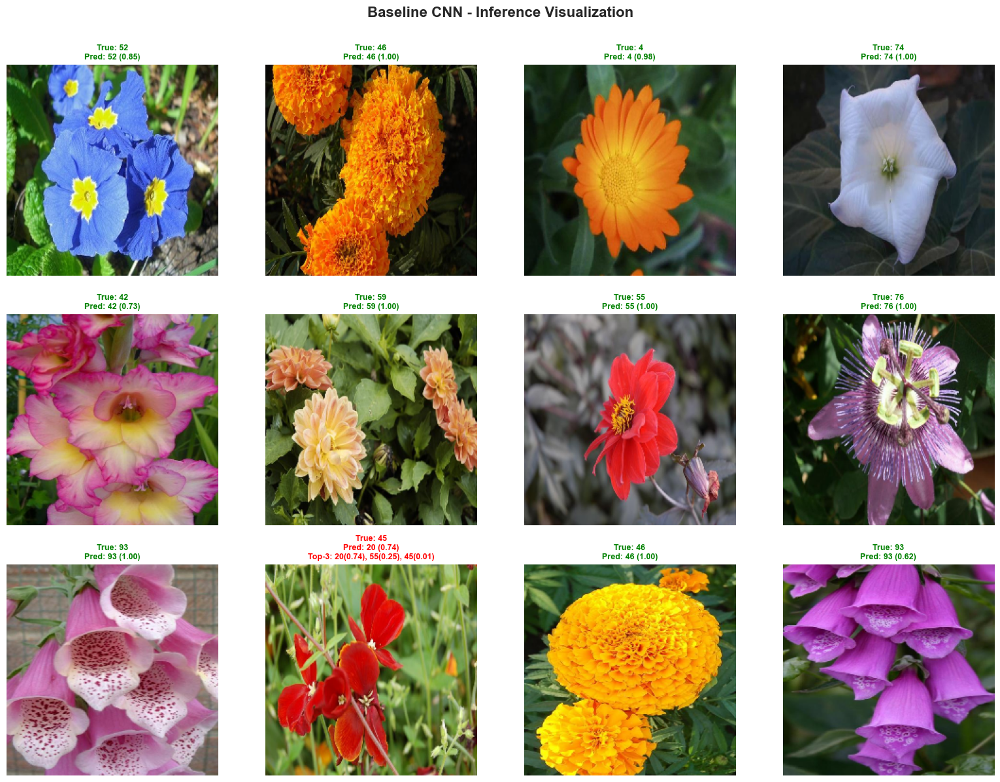


Visualizing ResNet50 predictions...
✓ Inference visualization saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\resnet50_inference_samples.png


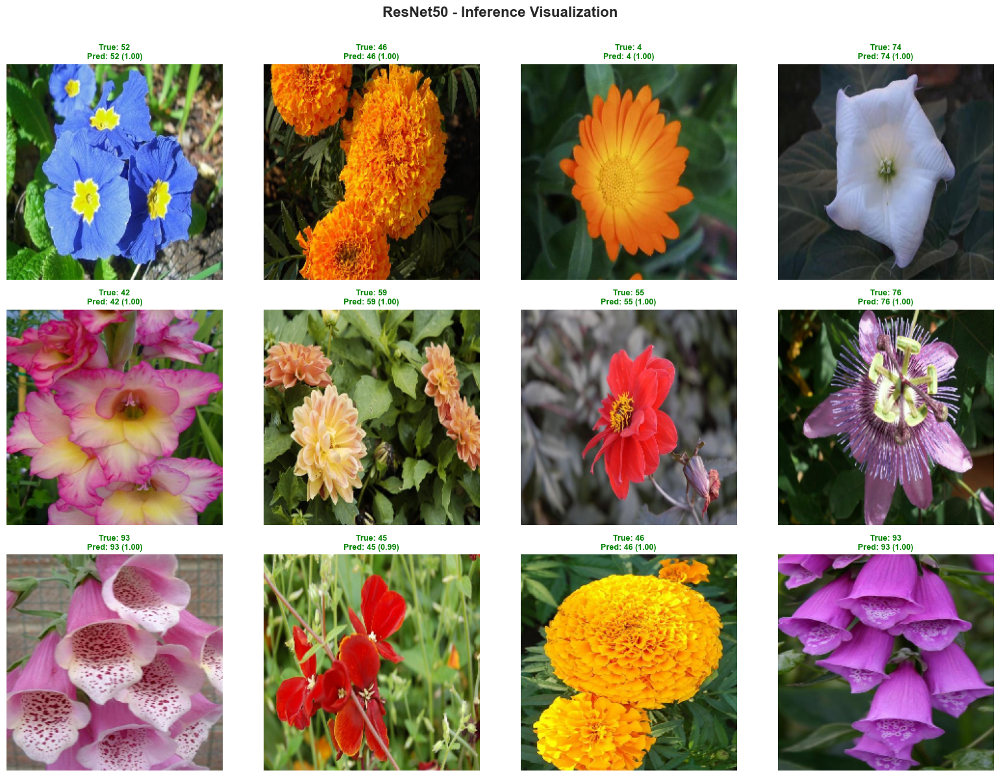


Visualizing EfficientNet-B3 predictions...
✓ Inference visualization saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\efficientnet-b3_inference_samples.png


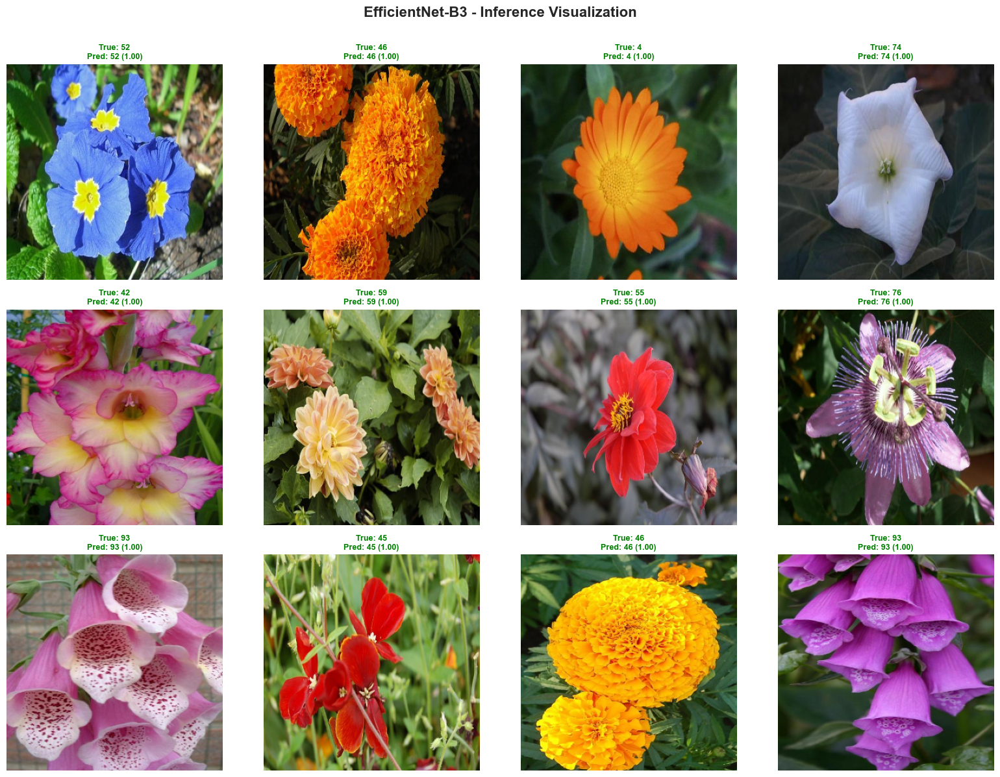

In [5]:
def visualize_inference(model, data_loader, model_name, device='cuda', n_samples=12, image_size=224):
    """Visualize model predictions on sample images."""
    model.eval()
    model.to(device)
    
    # Collect sample images and predictions
    images_list = []
    labels_list = []
    predictions_list = []
    probabilities_list = []
    
    with torch.no_grad():
        for images, labels in data_loader:
            images_gpu = images.to(device)
            outputs = model(images_gpu)
            probabilities = torch.softmax(outputs, dim=1)
            predictions = torch.argmax(outputs, dim=1)
            
            images_list.append(images.cpu())
            labels_list.append(labels.numpy())
            predictions_list.append(predictions.cpu().numpy())
            probabilities_list.append(probabilities.cpu().numpy())
            
            if len(np.concatenate(labels_list)) >= n_samples:
                break
    
    # Concatenate and select samples
    all_images = torch.cat(images_list, dim=0)[:n_samples]
    all_labels = np.concatenate(labels_list)[:n_samples]
    all_predictions = np.concatenate(predictions_list)[:n_samples]
    all_probabilities = np.concatenate(probabilities_list)[:n_samples]
    
    # Create visualization
    n_cols = 4
    n_rows = int(np.ceil(n_samples / n_cols))
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 4*n_rows))
    axes = axes.flatten() if n_samples > 1 else [axes]
    
    # Denormalization for visualization
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    
    for i in range(n_samples):
        # Get image and denormalize
        img = all_images[i].numpy().transpose(1, 2, 0)
        img = img * std + mean
        img = np.clip(img, 0, 1)
        
        true_label = all_labels[i]
        pred_label = all_predictions[i]
        confidence = all_probabilities[i, pred_label]
        
        # Get top-3 predictions
        top3_indices = np.argsort(all_probabilities[i])[-3:][::-1]
        top3_probs = all_probabilities[i, top3_indices]
        
        # Display image
        axes[i].imshow(img)
        axes[i].axis('off')
        
        # Create title with predictions
        color = 'green' if true_label == pred_label else 'red'
        title = f"True: {true_label}\n"
        title += f"Pred: {pred_label} ({confidence:.2f})"
        if true_label != pred_label:
            title += f"\nTop-3: {', '.join([f'{idx}({prob:.2f})' for idx, prob in zip(top3_indices, top3_probs)])}"
        
        axes[i].set_title(title, fontsize=9, color=color, fontweight='bold')
    
    # Hide empty subplots
    for i in range(n_samples, len(axes)):
        axes[i].axis('off')
    
    plt.suptitle(f'{model_name} - Inference Visualization', fontsize=16, fontweight='bold', y=0.995)
    plt.tight_layout(rect=[0, 0, 1, 0.99])
    
    save_path = FIGURES_DIR / f'{model_name.lower().replace(" ", "_")}_inference_samples.png'
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"✓ Inference visualization saved to {save_path}")
    plt.show()

# Visualize inference for each model
print("=" * 80)
print("INFERENCE VISUALIZATION")
print("=" * 80)

if baseline_model is not None and test_loader_224 is not None:
    print("\nVisualizing Baseline CNN predictions...")
    visualize_inference(baseline_model, test_loader_224, 'Baseline CNN', device=device, n_samples=12, image_size=224)

if resnet50_model is not None and test_loader_224 is not None:
    print("\nVisualizing ResNet50 predictions...")
    visualize_inference(resnet50_model, test_loader_224, 'ResNet50', device=device, n_samples=12, image_size=224)

if efficientnet_model is not None and test_loader_300 is not None:
    print("\nVisualizing EfficientNet-B3 predictions...")
    visualize_inference(efficientnet_model, test_loader_300, 'EfficientNet-B3', device=device, n_samples=12, image_size=300)

## 6. Error Analysis - Misclassified Examples

Visualize and analyze misclassified examples for each model.


MISCLASSIFIED EXAMPLES ANALYSIS

Analyzing Baseline CNN misclassifications...
Found 16 misclassified examples for Baseline CNN
✓ Misclassified examples saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\baseline_cnn_misclassified.png


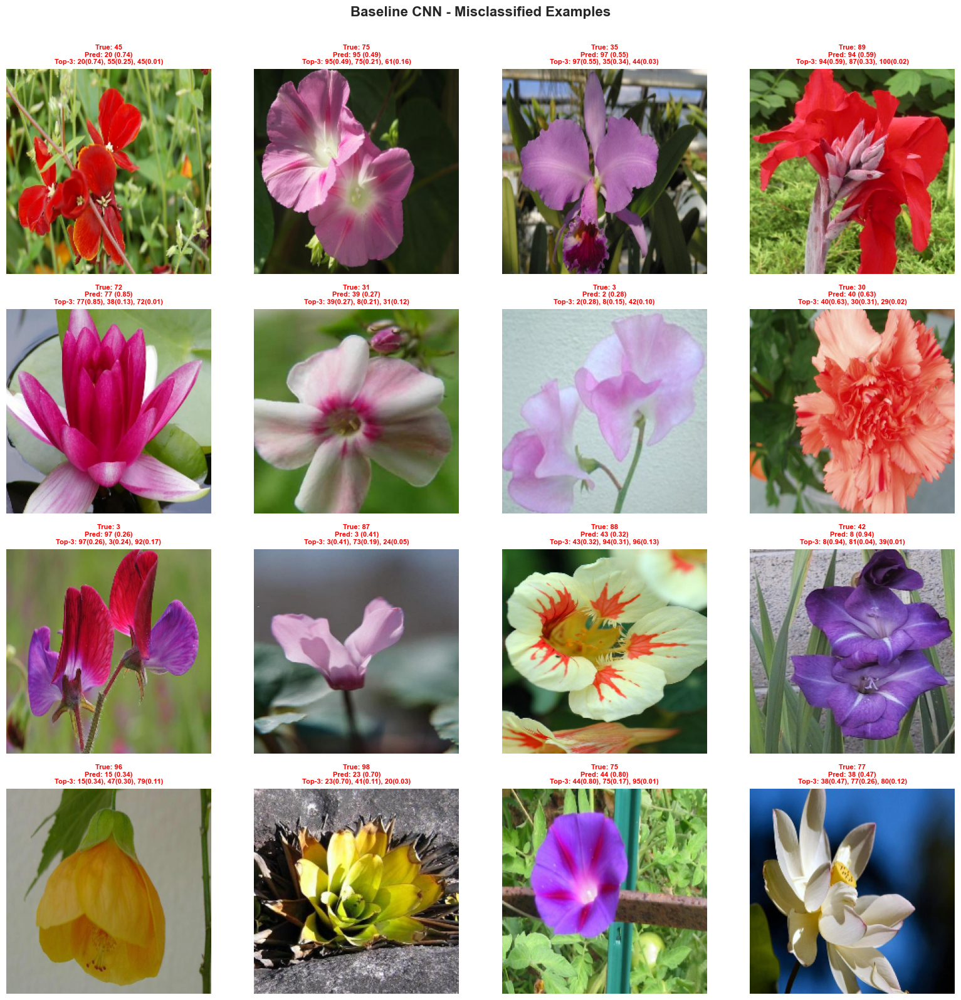


Analyzing ResNet50 misclassifications...
Found 16 misclassified examples for ResNet50
✓ Misclassified examples saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\resnet50_misclassified.png


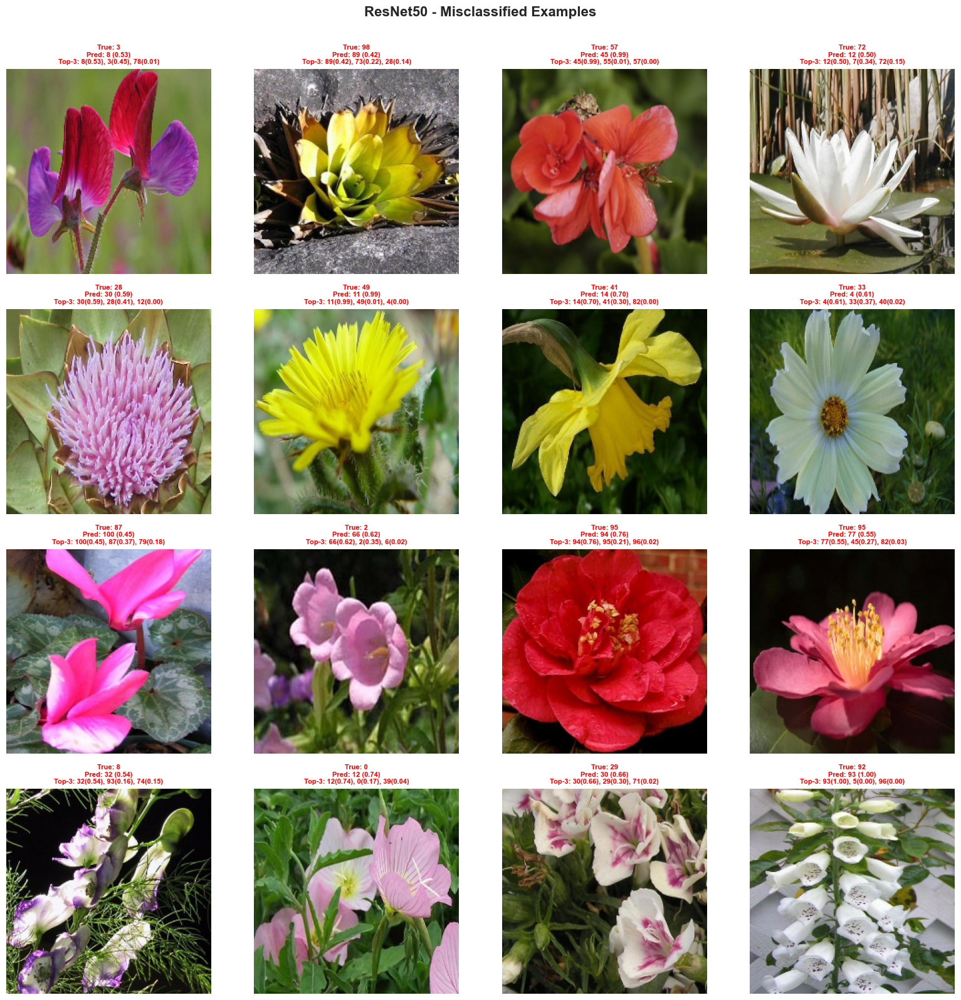


Analyzing EfficientNet-B3 misclassifications...
Found 13 misclassified examples for EfficientNet-B3
✓ Misclassified examples saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\efficientnet-b3_misclassified.png


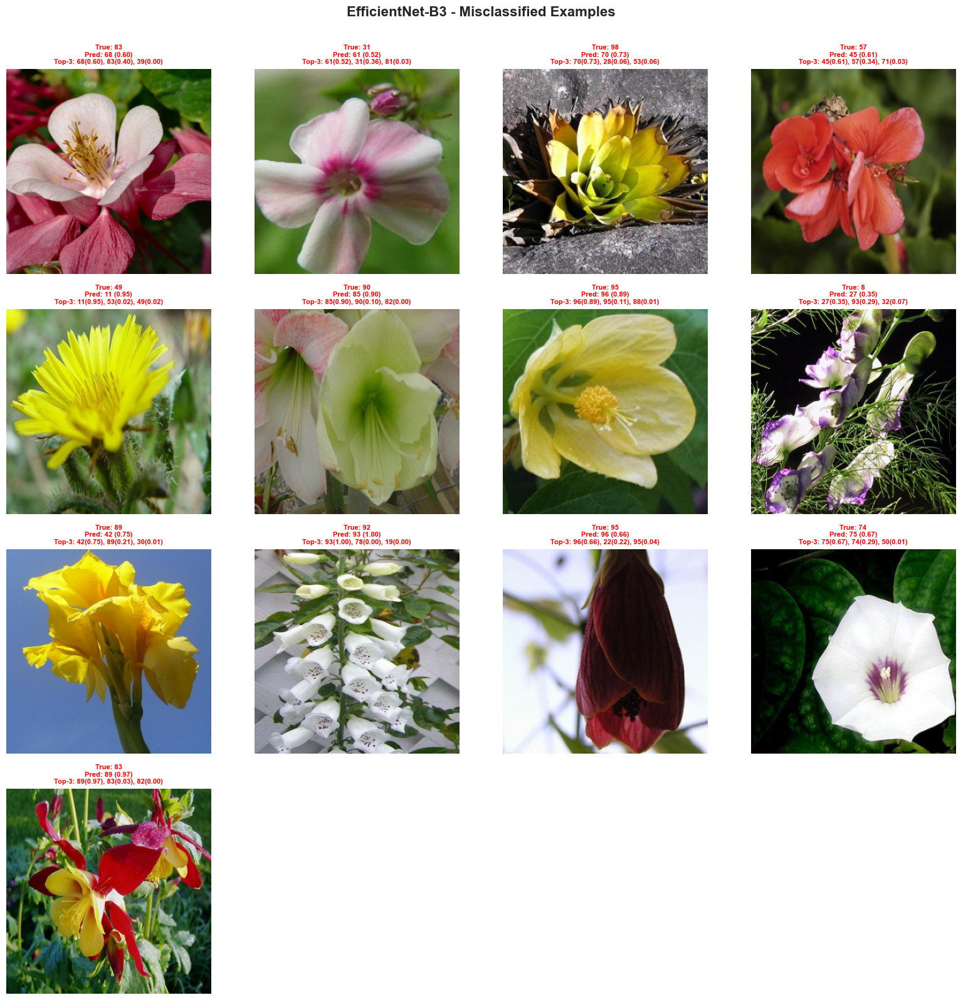

In [6]:
def visualize_misclassified_examples(model, data_loader, model_name, device='cuda', n_examples=16, image_size=224):
    """Visualize misclassified examples with predictions and confidence."""
    model.eval()
    model.to(device)
    
    misclassified_images = []
    misclassified_labels = []
    misclassified_predictions = []
    misclassified_confidences = []
    misclassified_top3 = []
    
    with torch.no_grad():
        for images, labels in data_loader:
            images_gpu = images.to(device)
            outputs = model(images_gpu)
            probabilities = torch.softmax(outputs, dim=1)
            predictions = torch.argmax(outputs, dim=1)
            
            # Find misclassified
            incorrect = (predictions.cpu().numpy() != labels.numpy())
            
            for i, is_incorrect in enumerate(incorrect):
                if is_incorrect and len(misclassified_images) < n_examples:
                    misclassified_images.append(images[i].cpu())
                    misclassified_labels.append(labels[i].item())
                    misclassified_predictions.append(predictions[i].item())
                    misclassified_confidences.append(probabilities[i, predictions[i]].item())
                    
                    # Get top-3 predictions
                    top3_idx = torch.topk(probabilities[i], 3).indices.cpu().numpy()
                    top3_probs = probabilities[i, top3_idx].cpu().numpy()
                    misclassified_top3.append((top3_idx, top3_probs))
            
            if len(misclassified_images) >= n_examples:
                break
    
    if len(misclassified_images) == 0:
        print(f"✓ No misclassified examples found for {model_name}!")
        return
    
    print(f"Found {len(misclassified_images)} misclassified examples for {model_name}")
    
    # Create visualization
    n_cols = 4
    n_rows = int(np.ceil(len(misclassified_images) / n_cols))
    fig, axes = plt.subplots(n_rows, n_cols, figsize=(16, 4*n_rows))
    axes = axes.flatten() if len(misclassified_images) > 1 else [axes]
    
    # Denormalization
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    
    for i in range(len(misclassified_images)):
        # Get image and denormalize
        img = misclassified_images[i].numpy().transpose(1, 2, 0)
        img = img * std + mean
        img = np.clip(img, 0, 1)
        
        true_label = misclassified_labels[i]
        pred_label = misclassified_predictions[i]
        confidence = misclassified_confidences[i]
        top3_idx, top3_probs = misclassified_top3[i]
        
        # Display image
        axes[i].imshow(img)
        axes[i].axis('off')
        
        # Create title
        title = f"True: {true_label}\n"
        title += f"Pred: {pred_label} ({confidence:.2f})\n"
        title += f"Top-3: {', '.join([f'{idx}({prob:.2f})' for idx, prob in zip(top3_idx[:3], top3_probs[:3])])}"
        
        axes[i].set_title(title, fontsize=8, color='red', fontweight='bold')
    
    # Hide empty subplots
    for i in range(len(misclassified_images), len(axes)):
        axes[i].axis('off')
    
    plt.suptitle(f'{model_name} - Misclassified Examples', fontsize=16, fontweight='bold', y=0.995)
    plt.tight_layout(rect=[0, 0, 1, 0.99])
    
    save_path = FIGURES_DIR / f'{model_name.lower().replace(" ", "_")}_misclassified.png'
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"✓ Misclassified examples saved to {save_path}")
    plt.show()

# Visualize misclassified examples for each model
print("\n" + "=" * 80)
print("MISCLASSIFIED EXAMPLES ANALYSIS")
print("=" * 80)

if baseline_model is not None and test_loader_224 is not None:
    print("\nAnalyzing Baseline CNN misclassifications...")
    visualize_misclassified_examples(baseline_model, test_loader_224, 'Baseline CNN', device=device, n_examples=16, image_size=224)

if resnet50_model is not None and test_loader_224 is not None:
    print("\nAnalyzing ResNet50 misclassifications...")
    visualize_misclassified_examples(resnet50_model, test_loader_224, 'ResNet50', device=device, n_examples=16, image_size=224)

if efficientnet_model is not None and test_loader_300 is not None:
    print("\nAnalyzing EfficientNet-B3 misclassifications...")
    visualize_misclassified_examples(efficientnet_model, test_loader_300, 'EfficientNet-B3', device=device, n_examples=16, image_size=300)

## 7. Error Analysis - Confusion Patterns

Analyze confusion patterns between classes to identify frequently confused pairs.


CONFUSION PATTERNS ANALYSIS

Analyzing Baseline CNN confusion patterns...


Getting predictions: 100%|██████████| 39/39 [00:35<00:00,  1.11it/s]


✓ Confusion patterns saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\baseline_cnn_confusion_patterns.png


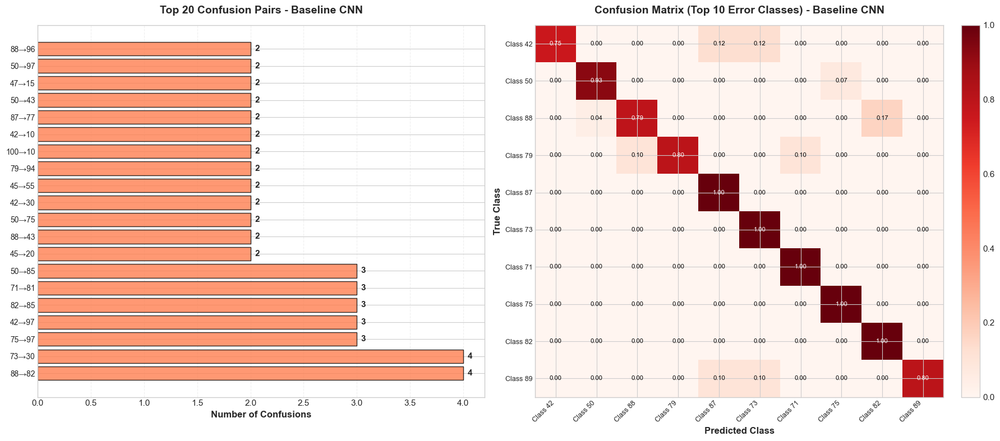


Analyzing ResNet50 confusion patterns...


Getting predictions: 100%|██████████| 39/39 [00:30<00:00,  1.28it/s]


✓ Confusion patterns saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\resnet50_confusion_patterns.png


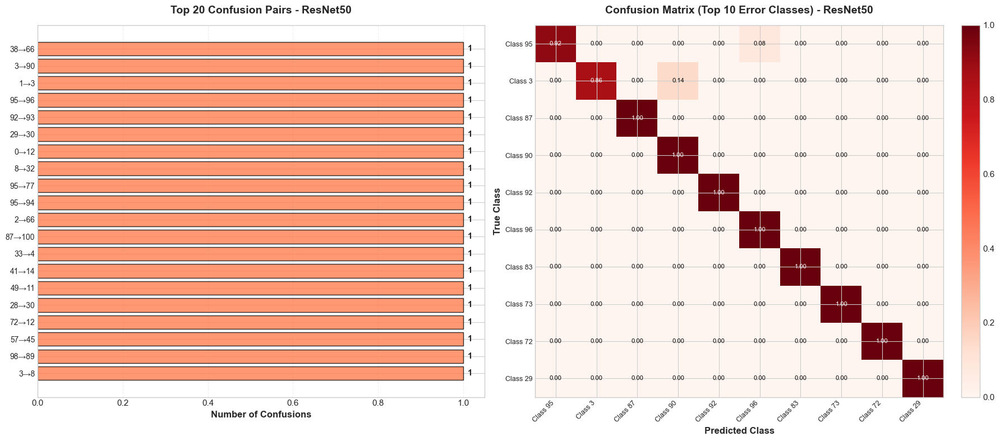


Analyzing EfficientNet-B3 confusion patterns...


Getting predictions: 100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


✓ Confusion patterns saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\efficientnet-b3_confusion_patterns.png


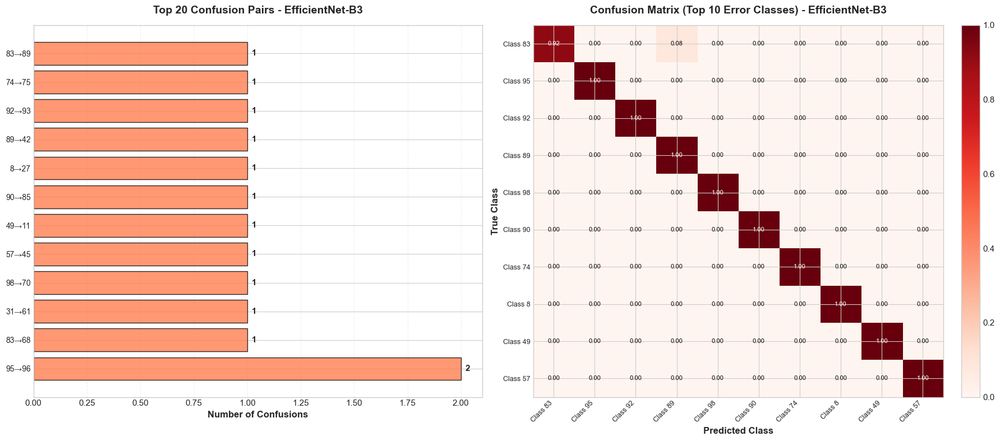

In [7]:
def analyze_confusion_patterns(model, data_loader, model_name, device='cuda', top_n=20):
    """Analyze and visualize confusion patterns."""
    # Get predictions
    results = get_predictions(model, data_loader, device=device)
    
    predictions = results['predictions']
    true_labels = results['true_labels']
    
    # Find misclassified
    errors = predictions != true_labels
    error_indices = np.where(errors)[0]
    
    # Count confusion pairs
    confusion_pairs = Counter()
    for idx in error_indices:
        pair = (true_labels[idx], predictions[idx])
        confusion_pairs[pair] += 1
    
    # Get top confusion pairs
    top_confusions = confusion_pairs.most_common(top_n)
    
    # Create visualization
    fig, axes = plt.subplots(1, 2, figsize=(18, 8))
    
    # Bar chart of top confusion pairs
    if top_confusions:
        pairs_labels = [f"{true}→{pred}" for (true, pred), count in top_confusions]
        counts = [count for (true, pred), count in top_confusions]
        
        axes[0].barh(range(len(pairs_labels)), counts, color='coral', alpha=0.8, edgecolor='black')
        axes[0].set_yticks(range(len(pairs_labels)))
        axes[0].set_yticklabels(pairs_labels, fontsize=10)
        axes[0].set_xlabel('Number of Confusions', fontsize=12, fontweight='bold')
        axes[0].set_title(f'Top {top_n} Confusion Pairs - {model_name}', fontsize=14, fontweight='bold', pad=15)
        axes[0].grid(True, alpha=0.3, axis='x', linestyle='--')
        
        # Add count labels
        for i, count in enumerate(counts):
            axes[0].text(count + max(counts)*0.01, i, str(count), va='center', fontweight='bold')
    
    # Confusion matrix (subset for readability)
    cm = confusion_matrix(true_labels, predictions)
    
    # Find classes with most errors
    class_errors = np.sum(cm, axis=1) - np.diag(cm)  # Errors per true class
    top_error_classes = np.argsort(class_errors)[-10:][::-1]
    
    # Subset confusion matrix to top error classes
    cm_subset = cm[np.ix_(top_error_classes, top_error_classes)]
    
    # Normalize
    cm_normalized = cm_subset.astype('float') / cm_subset.sum(axis=1)[:, np.newaxis]
    cm_normalized = np.nan_to_num(cm_normalized)
    
    im = axes[1].imshow(cm_normalized, cmap='Reds', aspect='auto', vmin=0, vmax=1)
    axes[1].set_xticks(range(len(top_error_classes)))
    axes[1].set_xticklabels([f"Class {c}" for c in top_error_classes], rotation=45, ha='right', fontsize=9)
    axes[1].set_yticks(range(len(top_error_classes)))
    axes[1].set_yticklabels([f"Class {c}" for c in top_error_classes], fontsize=9)
    axes[1].set_xlabel('Predicted Class', fontsize=12, fontweight='bold')
    axes[1].set_ylabel('True Class', fontsize=12, fontweight='bold')
    axes[1].set_title(f'Confusion Matrix (Top 10 Error Classes) - {model_name}', fontsize=14, fontweight='bold', pad=15)
    
    # Add colorbar
    plt.colorbar(im, ax=axes[1], fraction=0.046, pad=0.04)
    
    # Add values to confusion matrix
    thresh = cm_normalized.max() / 2.
    for i in range(len(top_error_classes)):
        for j in range(len(top_error_classes)):
            axes[1].text(j, i, f'{cm_normalized[i, j]:.2f}',
                       ha='center', va='center',
                       color='white' if cm_normalized[i, j] > thresh else 'black',
                       fontsize=8)
    
    plt.tight_layout()
    save_path = FIGURES_DIR / f'{model_name.lower().replace(" ", "_")}_confusion_patterns.png'
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"✓ Confusion patterns saved to {save_path}")
    plt.show()
    
    return top_confusions, class_errors

# Analyze confusion patterns for each model
print("\n" + "=" * 80)
print("CONFUSION PATTERNS ANALYSIS")
print("=" * 80)

confusion_results = {}

if baseline_model is not None and test_loader_224 is not None:
    print("\nAnalyzing Baseline CNN confusion patterns...")
    top_conf, class_err = analyze_confusion_patterns(baseline_model, test_loader_224, 'Baseline CNN', device=device)
    confusion_results['baseline'] = {'top_confusions': top_conf, 'class_errors': class_err}

if resnet50_model is not None and test_loader_224 is not None:
    print("\nAnalyzing ResNet50 confusion patterns...")
    top_conf, class_err = analyze_confusion_patterns(resnet50_model, test_loader_224, 'ResNet50', device=device)
    confusion_results['resnet50'] = {'top_confusions': top_conf, 'class_errors': class_err}

if efficientnet_model is not None and test_loader_300 is not None:
    print("\nAnalyzing EfficientNet-B3 confusion patterns...")
    top_conf, class_err = analyze_confusion_patterns(efficientnet_model, test_loader_300, 'EfficientNet-B3', device=device)
    confusion_results['efficientnet'] = {'top_confusions': top_conf, 'class_errors': class_err}

## 8. Error Analysis - Per-Class Performance

Analyze per-class accuracy, precision, recall, and F1-score to identify challenging classes.


PER-CLASS PERFORMANCE ANALYSIS

Analyzing Baseline CNN per-class performance...


Getting predictions: 100%|██████████| 39/39 [00:40<00:00,  1.04s/it]


✓ Per-class performance analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\baseline_cnn_per_class_performance.png


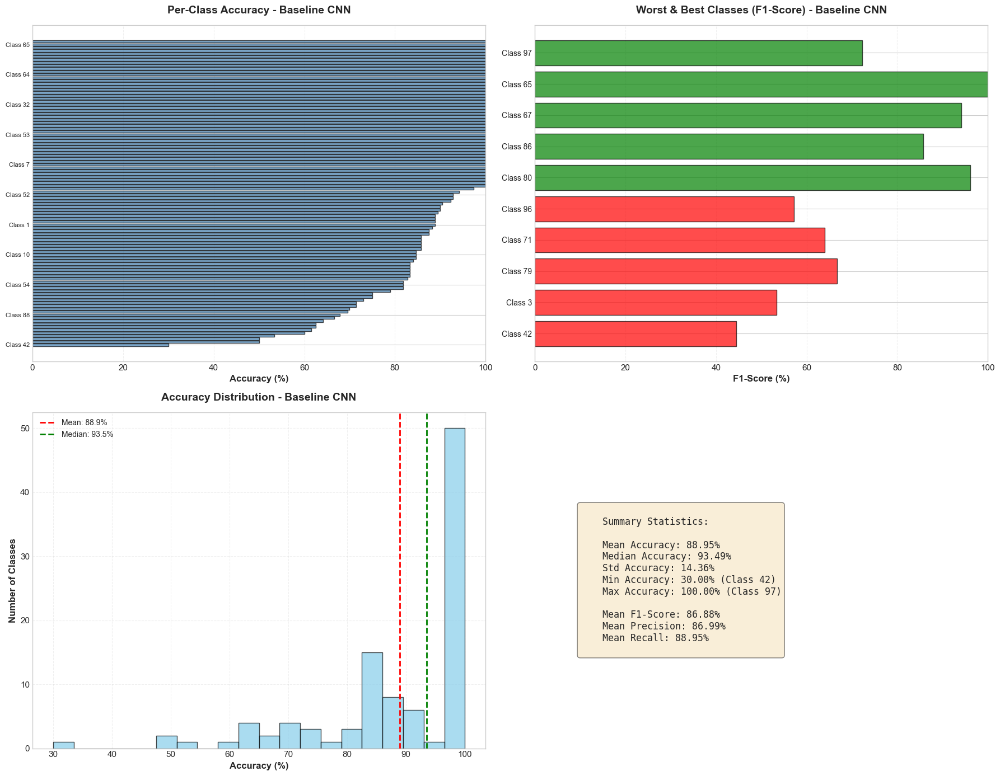


Analyzing ResNet50 per-class performance...


Getting predictions: 100%|██████████| 39/39 [00:26<00:00,  1.48it/s]


✓ Per-class performance analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\resnet50_per_class_performance.png


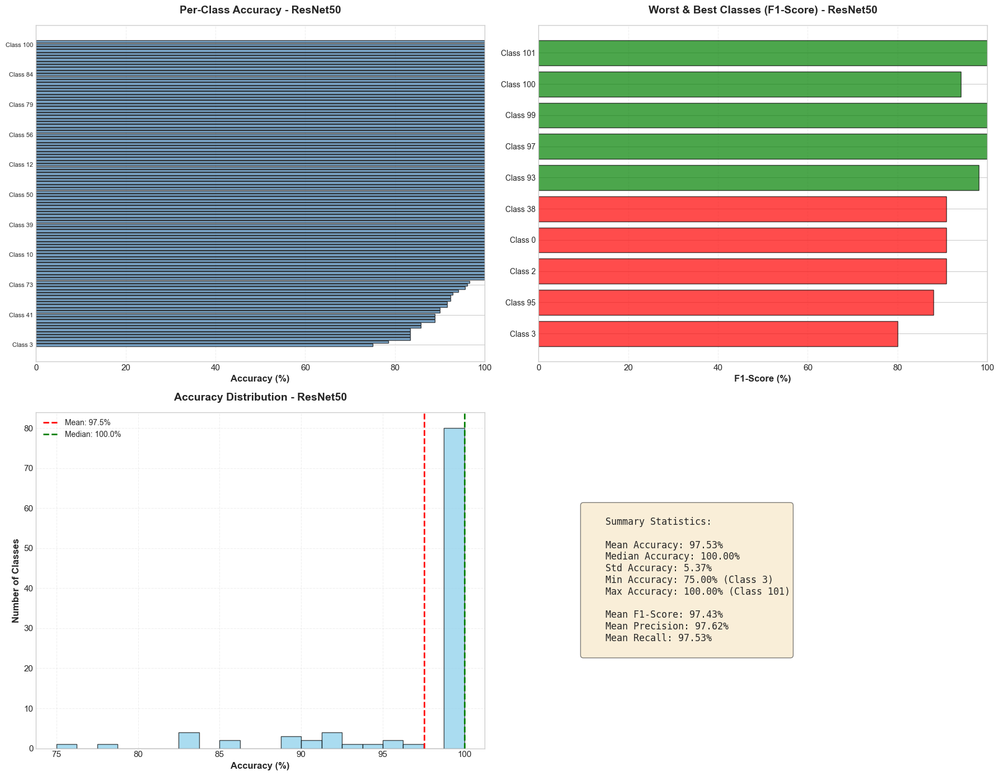


Analyzing EfficientNet-B3 per-class performance...


Getting predictions: 100%|██████████| 39/39 [00:34<00:00,  1.12it/s]


✓ Per-class performance analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\efficientnet-b3_per_class_performance.png


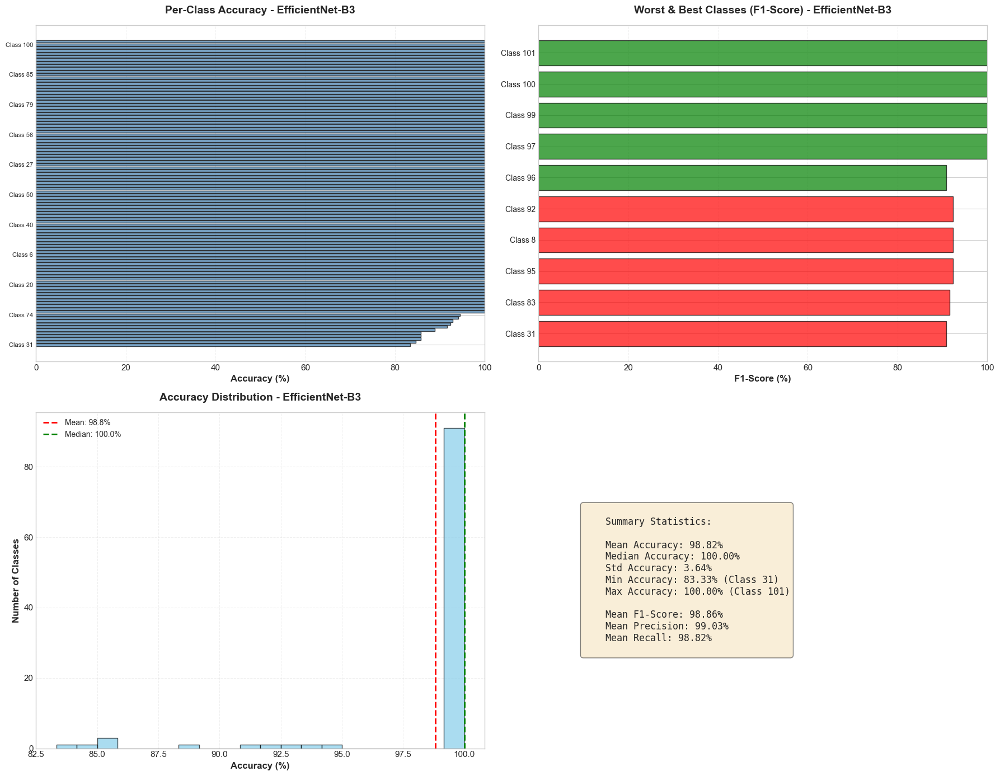

In [8]:
def analyze_per_class_performance(model, data_loader, model_name, device='cuda'):
    """Analyze and visualize per-class performance metrics."""
    # Get predictions
    results = get_predictions(model, data_loader, device=device)
    
    predictions = results['predictions']
    true_labels = results['true_labels']
    
    # Calculate per-class metrics
    precision, recall, f1, support = precision_recall_fscore_support(
        true_labels, predictions, labels=range(NUM_CLASSES), zero_division=0
    )
    
    # Calculate per-class accuracy
    per_class_acc = []
    for cls in range(NUM_CLASSES):
        cls_mask = true_labels == cls
        if cls_mask.sum() > 0:
            cls_acc = (predictions[cls_mask] == cls).sum() / cls_mask.sum() * 100
        else:
            cls_acc = 0
        per_class_acc.append(cls_acc)
    
    per_class_acc = np.array(per_class_acc)
    
    # Create visualization
    fig, axes = plt.subplots(2, 2, figsize=(18, 14))
    
    # Sort classes by performance
    sorted_indices = np.argsort(per_class_acc)
    
    # Per-class accuracy
    axes[0, 0].barh(range(NUM_CLASSES), per_class_acc[sorted_indices], color='steelblue', alpha=0.7, edgecolor='black')
    axes[0, 0].set_yticks(range(0, NUM_CLASSES, 10))
    axes[0, 0].set_yticklabels([f"Class {sorted_indices[i]}" for i in range(0, NUM_CLASSES, 10)], fontsize=8)
    axes[0, 0].set_xlabel('Accuracy (%)', fontsize=12, fontweight='bold')
    axes[0, 0].set_title(f'Per-Class Accuracy - {model_name}', fontsize=14, fontweight='bold', pad=15)
    axes[0, 0].grid(True, alpha=0.3, axis='x', linestyle='--')
    axes[0, 0].set_xlim([0, 100])
    
    # Highlight worst and best classes
    worst_5 = sorted_indices[:5]
    best_5 = sorted_indices[-5:]
    
    # Per-class F1-score (worst and best)
    worst_best_indices = np.concatenate([worst_5, best_5])
    worst_best_f1 = f1[worst_best_indices] * 100
    colors_wb = ['red'] * 5 + ['green'] * 5
    
    axes[0, 1].barh(range(len(worst_best_indices)), worst_best_f1, color=colors_wb, alpha=0.7, edgecolor='black')
    axes[0, 1].set_yticks(range(len(worst_best_indices)))
    axes[0, 1].set_yticklabels([f"Class {c}" for c in worst_best_indices], fontsize=10)
    axes[0, 1].set_xlabel('F1-Score (%)', fontsize=12, fontweight='bold')
    axes[0, 1].set_title(f'Worst & Best Classes (F1-Score) - {model_name}', fontsize=14, fontweight='bold', pad=15)
    axes[0, 1].grid(True, alpha=0.3, axis='x', linestyle='--')
    axes[0, 1].set_xlim([0, 100])
    
    # Performance distribution histogram
    axes[1, 0].hist(per_class_acc, bins=20, color='skyblue', alpha=0.7, edgecolor='black')
    axes[1, 0].axvline(per_class_acc.mean(), color='red', linestyle='--', linewidth=2, label=f'Mean: {per_class_acc.mean():.1f}%')
    axes[1, 0].axvline(np.median(per_class_acc), color='green', linestyle='--', linewidth=2, label=f'Median: {np.median(per_class_acc):.1f}%')
    axes[1, 0].set_xlabel('Accuracy (%)', fontsize=12, fontweight='bold')
    axes[1, 0].set_ylabel('Number of Classes', fontsize=12, fontweight='bold')
    axes[1, 0].set_title(f'Accuracy Distribution - {model_name}', fontsize=14, fontweight='bold', pad=15)
    axes[1, 0].legend(fontsize=10)
    axes[1, 0].grid(True, alpha=0.3, linestyle='--')
    
    # Summary statistics
    stats_text = f"""
    Summary Statistics:
    
    Mean Accuracy: {per_class_acc.mean():.2f}%
    Median Accuracy: {np.median(per_class_acc):.2f}%
    Std Accuracy: {per_class_acc.std():.2f}%
    Min Accuracy: {per_class_acc.min():.2f}% (Class {worst_5[0]})
    Max Accuracy: {per_class_acc.max():.2f}% (Class {best_5[-1]})
    
    Mean F1-Score: {f1.mean()*100:.2f}%
    Mean Precision: {precision.mean()*100:.2f}%
    Mean Recall: {recall.mean()*100:.2f}%
    """
    
    axes[1, 1].text(0.1, 0.5, stats_text, fontsize=12, verticalalignment='center',
                   family='monospace', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    axes[1, 1].axis('off')
    
    plt.tight_layout()
    save_path = FIGURES_DIR / f'{model_name.lower().replace(" ", "_")}_per_class_performance.png'
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"✓ Per-class performance analysis saved to {save_path}")
    plt.show()
    
    return {
        'per_class_accuracy': per_class_acc,
        'precision': precision,
        'recall': recall,
        'f1': f1,
        'support': support,
        'worst_classes': worst_5,
        'best_classes': best_5
    }

# Analyze per-class performance for each model
print("\n" + "=" * 80)
print("PER-CLASS PERFORMANCE ANALYSIS")
print("=" * 80)

per_class_results = {}

if baseline_model is not None and test_loader_224 is not None:
    print("\nAnalyzing Baseline CNN per-class performance...")
    per_class_results['baseline'] = analyze_per_class_performance(baseline_model, test_loader_224, 'Baseline CNN', device=device)

if resnet50_model is not None and test_loader_224 is not None:
    print("\nAnalyzing ResNet50 per-class performance...")
    per_class_results['resnet50'] = analyze_per_class_performance(resnet50_model, test_loader_224, 'ResNet50', device=device)

if efficientnet_model is not None and test_loader_300 is not None:
    print("\nAnalyzing EfficientNet-B3 per-class performance...")
    per_class_results['efficientnet'] = analyze_per_class_performance(efficientnet_model, test_loader_300, 'EfficientNet-B3', device=device)

## 9. Error Analysis - Confidence Analysis

Analyze prediction confidence for correct vs incorrect predictions.


CONFIDENCE ANALYSIS

Analyzing Baseline CNN confidence...


Getting predictions: 100%|██████████| 39/39 [00:39<00:00,  1.02s/it]


✓ Confidence analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\baseline_cnn_confidence_analysis.png


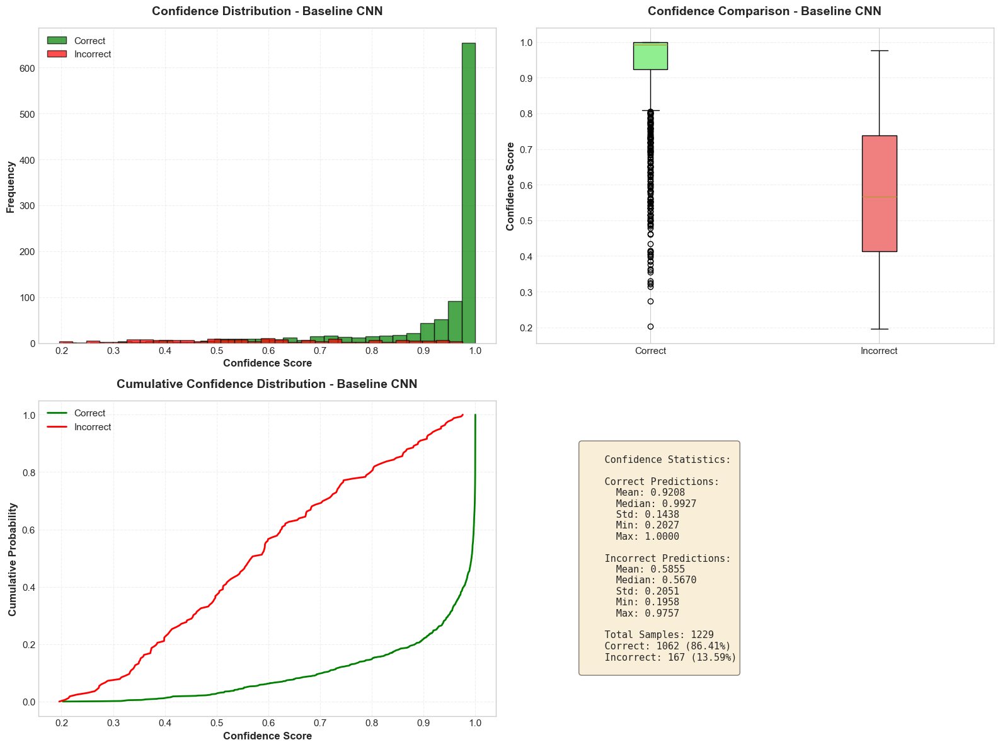


Analyzing ResNet50 confidence...


Getting predictions: 100%|██████████| 39/39 [00:29<00:00,  1.34it/s]


✓ Confidence analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\resnet50_confidence_analysis.png


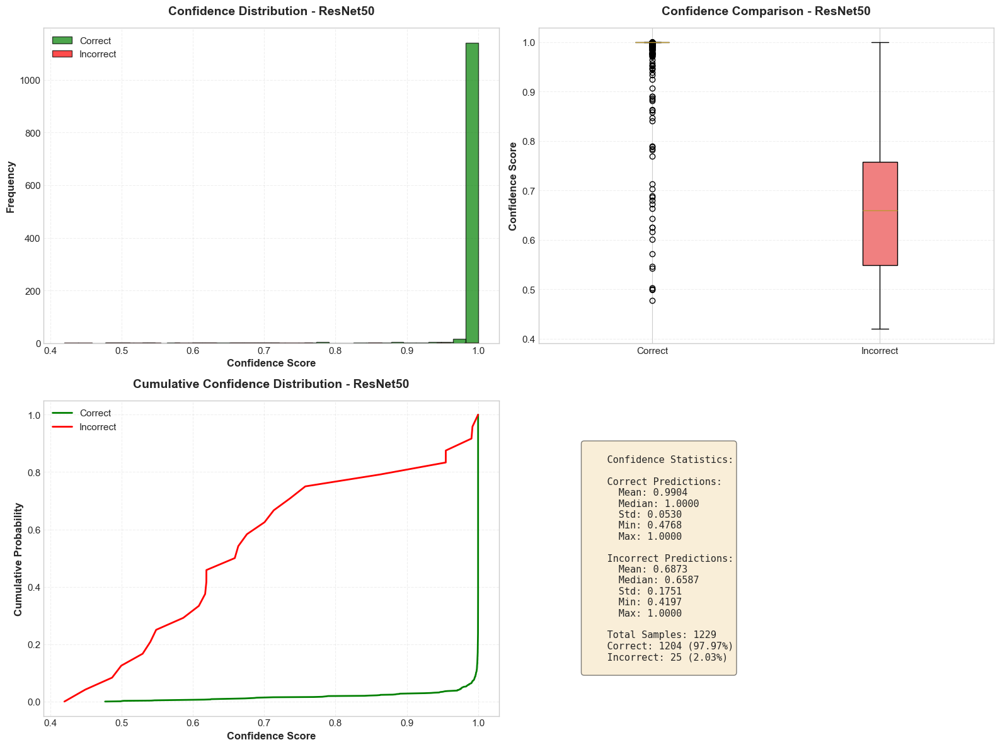


Analyzing EfficientNet-B3 confidence...


Getting predictions: 100%|██████████| 39/39 [00:32<00:00,  1.20it/s]


✓ Confidence analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\efficientnet-b3_confidence_analysis.png


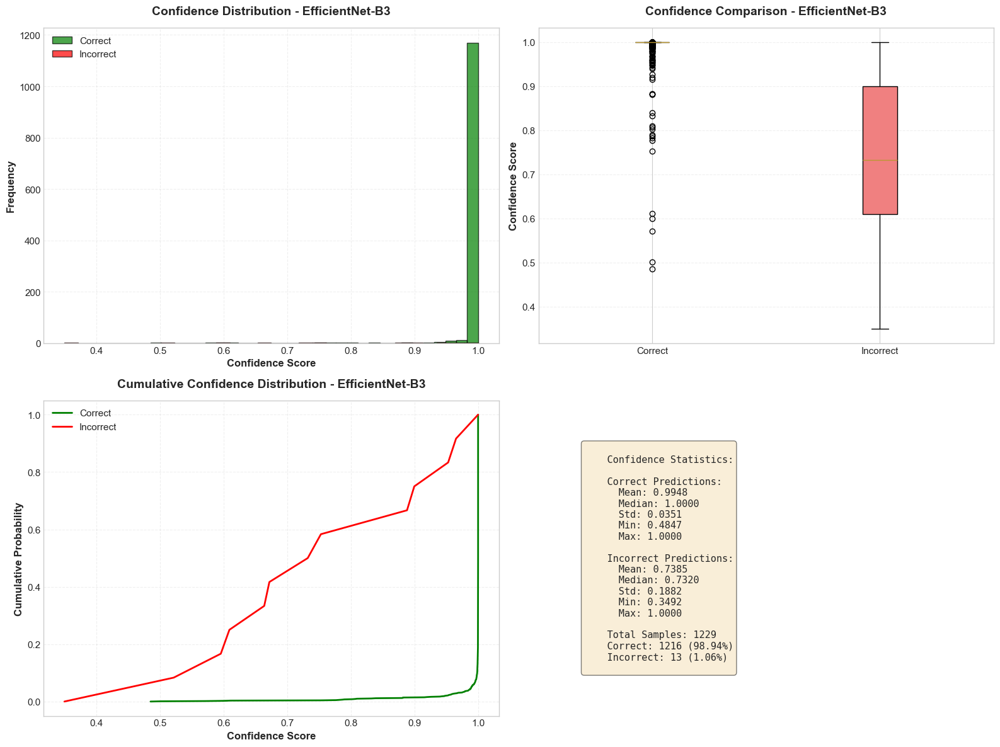

In [9]:
def analyze_confidence(model, data_loader, model_name, device='cuda'):
    """Analyze prediction confidence distribution."""
    # Get predictions
    results = get_predictions(model, data_loader, device=device)
    
    predictions = results['predictions']
    true_labels = results['true_labels']
    probabilities = results['probabilities']
    
    # Get confidence scores (probability of predicted class)
    confidences = probabilities[np.arange(len(predictions)), predictions]
    
    # Separate correct and incorrect predictions
    correct_mask = predictions == true_labels
    correct_confidences = confidences[correct_mask]
    incorrect_confidences = confidences[~correct_mask]
    
    # Create visualization
    fig, axes = plt.subplots(2, 2, figsize=(16, 12))
    
    # Confidence distribution - histogram
    axes[0, 0].hist(correct_confidences, bins=30, alpha=0.7, label='Correct', color='green', edgecolor='black')
    axes[0, 0].hist(incorrect_confidences, bins=30, alpha=0.7, label='Incorrect', color='red', edgecolor='black')
    axes[0, 0].set_xlabel('Confidence Score', fontsize=12, fontweight='bold')
    axes[0, 0].set_ylabel('Frequency', fontsize=12, fontweight='bold')
    axes[0, 0].set_title(f'Confidence Distribution - {model_name}', fontsize=14, fontweight='bold', pad=15)
    axes[0, 0].legend(fontsize=11)
    axes[0, 0].grid(True, alpha=0.3, linestyle='--')
    
    # Confidence distribution - box plot
    box_data = [correct_confidences, incorrect_confidences]
    bp = axes[0, 1].boxplot(box_data, labels=['Correct', 'Incorrect'], patch_artist=True)
    bp['boxes'][0].set_facecolor('lightgreen')
    bp['boxes'][1].set_facecolor('lightcoral')
    axes[0, 1].set_ylabel('Confidence Score', fontsize=12, fontweight='bold')
    axes[0, 1].set_title(f'Confidence Comparison - {model_name}', fontsize=14, fontweight='bold', pad=15)
    axes[0, 1].grid(True, alpha=0.3, axis='y', linestyle='--')
    
    # Cumulative distribution
    sorted_correct = np.sort(correct_confidences)
    sorted_incorrect = np.sort(incorrect_confidences)
    
    axes[1, 0].plot(sorted_correct, np.linspace(0, 1, len(sorted_correct)), 
                   label='Correct', linewidth=2, color='green')
    axes[1, 0].plot(sorted_incorrect, np.linspace(0, 1, len(sorted_incorrect)), 
                   label='Incorrect', linewidth=2, color='red')
    axes[1, 0].set_xlabel('Confidence Score', fontsize=12, fontweight='bold')
    axes[1, 0].set_ylabel('Cumulative Probability', fontsize=12, fontweight='bold')
    axes[1, 0].set_title(f'Cumulative Confidence Distribution - {model_name}', fontsize=14, fontweight='bold', pad=15)
    axes[1, 0].legend(fontsize=11)
    axes[1, 0].grid(True, alpha=0.3, linestyle='--')
    
    # Statistics summary
    stats_text = f"""
    Confidence Statistics:
    
    Correct Predictions:
      Mean: {correct_confidences.mean():.4f}
      Median: {np.median(correct_confidences):.4f}
      Std: {correct_confidences.std():.4f}
      Min: {correct_confidences.min():.4f}
      Max: {correct_confidences.max():.4f}
    
    Incorrect Predictions:
      Mean: {incorrect_confidences.mean():.4f}
      Median: {np.median(incorrect_confidences):.4f}
      Std: {incorrect_confidences.std():.4f}
      Min: {incorrect_confidences.min():.4f}
      Max: {incorrect_confidences.max():.4f}
    
    Total Samples: {len(predictions)}
    Correct: {len(correct_confidences)} ({len(correct_confidences)/len(predictions)*100:.2f}%)
    Incorrect: {len(incorrect_confidences)} ({len(incorrect_confidences)/len(predictions)*100:.2f}%)
    """
    
    axes[1, 1].text(0.1, 0.5, stats_text, fontsize=11, verticalalignment='center',
                   family='monospace', bbox=dict(boxstyle='round', facecolor='wheat', alpha=0.5))
    axes[1, 1].axis('off')
    
    plt.tight_layout()
    save_path = FIGURES_DIR / f'{model_name.lower().replace(" ", "_")}_confidence_analysis.png'
    plt.savefig(save_path, dpi=150, bbox_inches='tight')
    print(f"✓ Confidence analysis saved to {save_path}")
    plt.show()
    
    return {
        'correct_confidences': correct_confidences,
        'incorrect_confidences': incorrect_confidences,
        'mean_correct': correct_confidences.mean(),
        'mean_incorrect': incorrect_confidences.mean()
    }

# Analyze confidence for each model
print("\n" + "=" * 80)
print("CONFIDENCE ANALYSIS")
print("=" * 80)

confidence_results = {}

if baseline_model is not None and test_loader_224 is not None:
    print("\nAnalyzing Baseline CNN confidence...")
    confidence_results['baseline'] = analyze_confidence(baseline_model, test_loader_224, 'Baseline CNN', device=device)

if resnet50_model is not None and test_loader_224 is not None:
    print("\nAnalyzing ResNet50 confidence...")
    confidence_results['resnet50'] = analyze_confidence(resnet50_model, test_loader_224, 'ResNet50', device=device)

if efficientnet_model is not None and test_loader_300 is not None:
    print("\nAnalyzing EfficientNet-B3 confidence...")
    confidence_results['efficientnet'] = analyze_confidence(efficientnet_model, test_loader_300, 'EfficientNet-B3', device=device)

## 10. Model Comparison on Failure Cases

Compare how different models perform on the same failure cases.


MODEL COMPARISON ON FAILURE CASES

Getting Baseline CNN predictions...


Getting predictions: 100%|██████████| 39/39 [00:40<00:00,  1.03s/it]


Getting ResNet50 predictions...


Getting predictions: 100%|██████████| 39/39 [00:27<00:00,  1.40it/s]


Getting EfficientNet-B3 predictions...


Getting predictions: 100%|██████████| 39/39 [00:29<00:00,  1.31it/s]



Analyzing common failure cases...
Found 14 samples where both Baseline CNN and ResNet50 failed
✓ Common failure cases comparison saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\common_failure_cases_comparison.png


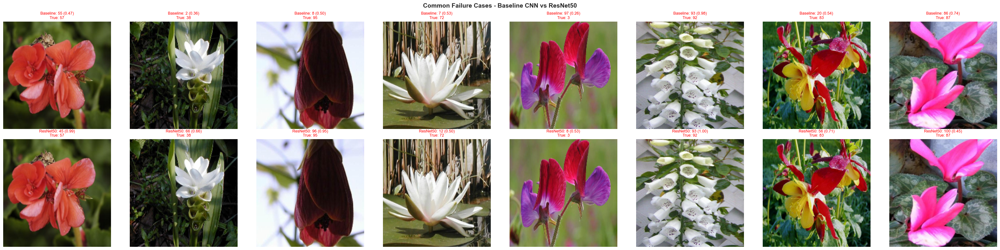


Creating error overlap analysis...
✓ Error overlap analysis saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures\error_overlap_analysis.png


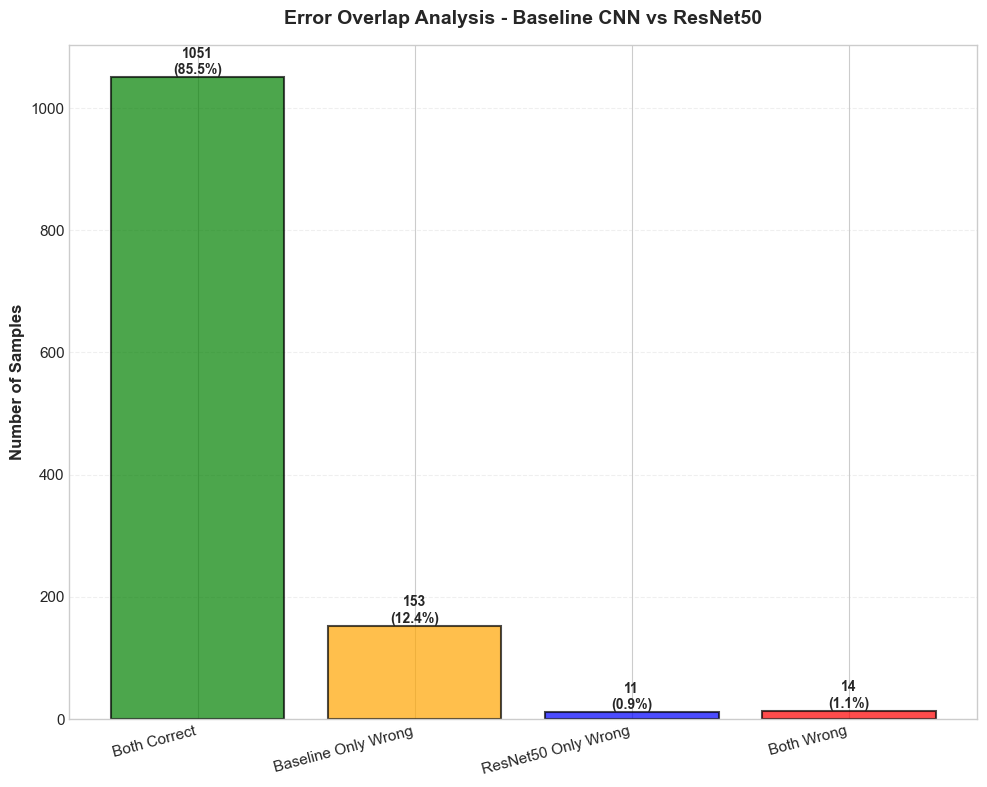

In [10]:
# Get predictions for all models
print("\n" + "=" * 80)
print("MODEL COMPARISON ON FAILURE CASES")
print("=" * 80)

# Collect all predictions
all_results = {}

if baseline_model is not None and test_loader_224 is not None:
    print("\nGetting Baseline CNN predictions...")
    all_results['baseline'] = get_predictions(baseline_model, test_loader_224, device=device)

if resnet50_model is not None and test_loader_224 is not None:
    print("Getting ResNet50 predictions...")
    all_results['resnet50'] = get_predictions(resnet50_model, test_loader_224, device=device)

if efficientnet_model is not None and test_loader_300 is not None:
    print("Getting EfficientNet-B3 predictions...")
    all_results['efficientnet'] = get_predictions(efficientnet_model, test_loader_300, device=device)

# Find samples where all models failed (if multiple models available)
if len(all_results) > 1:
    print("\nAnalyzing common failure cases...")
    
    # Get error masks for each model (only for models using same image size)
    models_224 = {}
    if 'baseline' in all_results:
        models_224['baseline'] = all_results['baseline']
    if 'resnet50' in all_results:
        models_224['resnet50'] = all_results['resnet50']
    
    if len(models_224) >= 2:
        # Find indices where both models failed
        baseline_errors = models_224['baseline']['predictions'] != models_224['baseline']['true_labels']
        resnet50_errors = models_224['resnet50']['predictions'] != models_224['resnet50']['true_labels']
        
        common_errors = baseline_errors & resnet50_errors
        common_error_indices = np.where(common_errors)[0]
        
        print(f"Found {len(common_error_indices)} samples where both Baseline CNN and ResNet50 failed")
        
        # Visualize common failures
        if len(common_error_indices) > 0:
            n_samples = min(8, len(common_error_indices))
            sample_indices = np.random.choice(common_error_indices, n_samples, replace=False)
            
            fig, axes = plt.subplots(2, n_samples, figsize=(4*n_samples, 8))
            if n_samples == 1:
                axes = axes.reshape(2, 1)
            
            mean = np.array([0.485, 0.456, 0.406])
            std = np.array([0.229, 0.224, 0.225])
            
            # Get images from dataset
            for col, idx in enumerate(sample_indices):
                # Get image from dataset
                image, true_label = test_dataset_224[idx]
                img = image.numpy().transpose(1, 2, 0) * std + mean
                img = np.clip(img, 0, 1)
                
                # Baseline CNN prediction
                axes[0, col].imshow(img)
                axes[0, col].axis('off')
                baseline_pred = models_224['baseline']['predictions'][idx]
                baseline_conf = models_224['baseline']['probabilities'][idx, baseline_pred]
                axes[0, col].set_title(
                    f"Baseline: {baseline_pred} ({baseline_conf:.2f})\nTrue: {true_label}",
                    fontsize=9, color='red'
                )
                
                # ResNet50 prediction
                axes[1, col].imshow(img)
                axes[1, col].axis('off')
                resnet50_pred = models_224['resnet50']['predictions'][idx]
                resnet50_conf = models_224['resnet50']['probabilities'][idx, resnet50_pred]
                axes[1, col].set_title(
                    f"ResNet50: {resnet50_pred} ({resnet50_conf:.2f})\nTrue: {true_label}",
                    fontsize=9, color='red'
                )
            
            plt.suptitle('Common Failure Cases - Baseline CNN vs ResNet50', fontsize=14, fontweight='bold')
            plt.tight_layout()
            save_path = FIGURES_DIR / 'common_failure_cases_comparison.png'
            plt.savefig(save_path, dpi=150, bbox_inches='tight')
            print(f"✓ Common failure cases comparison saved to {save_path}")
            plt.show()

# Create error overlap matrix
if len(all_results) > 1:
    print("\nCreating error overlap analysis...")
    
    # Compare models with same image size
    if 'baseline' in all_results and 'resnet50' in all_results:
        baseline_errors = all_results['baseline']['predictions'] != all_results['baseline']['true_labels']
        resnet50_errors = all_results['resnet50']['predictions'] != all_results['resnet50']['true_labels']
        
        # Create overlap matrix
        both_correct = (~baseline_errors) & (~resnet50_errors)
        baseline_only = baseline_errors & (~resnet50_errors)
        resnet50_only = (~baseline_errors) & resnet50_errors
        both_wrong = baseline_errors & resnet50_errors
        
        fig, ax = plt.subplots(figsize=(10, 8))
        
        categories = ['Both Correct', 'Baseline Only Wrong', 'ResNet50 Only Wrong', 'Both Wrong']
        counts = [both_correct.sum(), baseline_only.sum(), resnet50_only.sum(), both_wrong.sum()]
        colors = ['green', 'orange', 'blue', 'red']
        
        bars = ax.bar(categories, counts, color=colors, alpha=0.7, edgecolor='black', linewidth=1.5)
        ax.set_ylabel('Number of Samples', fontsize=12, fontweight='bold')
        ax.set_title('Error Overlap Analysis - Baseline CNN vs ResNet50', fontsize=14, fontweight='bold', pad=15)
        ax.grid(True, alpha=0.3, axis='y', linestyle='--')
        
        # Add count labels
        for bar, count in zip(bars, counts):
            height = bar.get_height()
            ax.text(bar.get_x() + bar.get_width()/2., height,
                   f'{count}\n({count/len(baseline_errors)*100:.1f}%)',
                   ha='center', va='bottom', fontweight='bold', fontsize=10)
        
        plt.xticks(rotation=15, ha='right')
        plt.tight_layout()
        save_path = FIGURES_DIR / 'error_overlap_analysis.png'
        plt.savefig(save_path, dpi=150, bbox_inches='tight')
        print(f"✓ Error overlap analysis saved to {save_path}")
        plt.show()

## 11. Summary

Summary of inference visualization and error analysis results.

In [12]:
# Create visual summary report
from matplotlib.patches import Rectangle
from matplotlib.gridspec import GridSpec

summary_path = FIGURES_DIR / 'inference_error_analysis_summary.png'

# Collect data for visualization
summary_data = []
for model_key, model_name in [('baseline', 'Baseline CNN'), ('resnet50', 'ResNet50'), ('efficientnet', 'EfficientNet-B3')]:
    if model_key in all_results:
        results = all_results[model_key]
        predictions = results['predictions']
        true_labels = results['true_labels']
        
        errors = predictions != true_labels
        accuracy = (1 - errors.mean()) * 100
        
        model_data = {
            'name': model_name,
            'accuracy': accuracy,
            'total_errors': errors.sum(),
            'error_rate': errors.mean() * 100,
            'top_confusions': [],
            'mean_per_class_acc': None,
            'worst_classes': [],
            'best_classes': [],
            'mean_conf_correct': None,
            'mean_conf_incorrect': None
        }
        
        # Confusion patterns
        if model_key in confusion_results:
            model_data['top_confusions'] = confusion_results[model_key]['top_confusions'][:5]
        
        # Per-class performance
        if model_key in per_class_results:
            per_class = per_class_results[model_key]
            model_data['mean_per_class_acc'] = per_class['per_class_accuracy'].mean()
            model_data['worst_classes'] = per_class['worst_classes'].tolist()
            model_data['best_classes'] = per_class['best_classes'].tolist()
        
        # Confidence analysis
        if model_key in confidence_results:
            conf = confidence_results[model_key]
            model_data['mean_conf_correct'] = conf['mean_correct']
            model_data['mean_conf_incorrect'] = conf['mean_incorrect']
        
        summary_data.append(model_data)

# Create figure
fig = plt.figure(figsize=(20, 14))
gs = GridSpec(3, 3, figure=fig, hspace=0.3, wspace=0.3, 
              left=0.05, right=0.95, top=0.93, bottom=0.05)

# Title
fig.suptitle('INFERENCE VISUALIZATION & ERROR ANALYSIS SUMMARY', 
             fontsize=20, fontweight='bold', y=0.98)

# Header info
header_text = f"Analysis Date: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}\n"
header_text += f"Dataset: Oxford 102 Flower Dataset\n"
header_text += f"Number of Classes: {NUM_CLASSES}"
fig.text(0.5, 0.955, header_text, ha='center', va='top', fontsize=11, 
         bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.3))

# Create sections for each model
model_colors = {'Baseline CNN': '#FF6B6B', 'ResNet50': '#4ECDC4', 'EfficientNet-B3': '#95E1D3'}
y_positions = [0.82, 0.50, 0.18]

for idx, data in enumerate(summary_data):
    y_base = y_positions[idx]
    color = model_colors.get(data['name'], '#CCCCCC')
    
    # Model title
    fig.text(0.05, y_base + 0.10, f"{data['name'].upper()}", 
             fontsize=14, fontweight='bold', color=color)
    
    # Draw divider line
    line = plt.Line2D([0.05, 0.95], [y_base + 0.08, y_base + 0.08], 
                      transform=fig.transFigure, color=color, linewidth=2)
    fig.add_artist(line)
    
    # Metrics section
    metrics_text = f"Test Accuracy: {data['accuracy']:.2f}%\n"
    metrics_text += f"Total Errors: {data['total_errors']}\n"
    metrics_text += f"Error Rate: {data['error_rate']:.2f}%"
    fig.text(0.07, y_base + 0.05, metrics_text, fontsize=10, 
             verticalalignment='top', family='monospace',
             bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))
    
    # Confusion pairs
    if data['top_confusions']:
        conf_text = "Top 5 Confusion Pairs:\n"
        for (true, pred), count in data['top_confusions']:
            conf_text += f"  Class {true} -> Class {pred}: {count} times\n"
        fig.text(0.35, y_base + 0.05, conf_text, fontsize=9,
                 verticalalignment='top', family='monospace',
                 bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))
    
    # Per-class performance
    if data['mean_per_class_acc'] is not None:
        perf_text = "Per-Class Performance:\n"
        perf_text += f"  Mean Accuracy: {data['mean_per_class_acc']:.2f}%\n"
        perf_text += f"  Worst Classes: {data['worst_classes']}\n"
        perf_text += f"  Best Classes: {data['best_classes']}"
        fig.text(0.62, y_base + 0.05, perf_text, fontsize=9,
                 verticalalignment='top', family='monospace',
                 bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))
    
    # Confidence analysis
    if data['mean_conf_correct'] is not None:
        conf_text = "Confidence Analysis:\n"
        conf_text += f"  Mean (Correct): {data['mean_conf_correct']:.4f}\n"
        conf_text += f"  Mean (Incorrect): {data['mean_conf_incorrect']:.4f}"
        fig.text(0.85, y_base + 0.05, conf_text, fontsize=9,
                 verticalalignment='top', ha='right', family='monospace',
                 bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))

# Key Findings section
findings_y = 0.10
fig.text(0.5, findings_y + 0.025, "KEY FINDINGS", 
         fontsize=14, fontweight='bold', ha='center',
         bbox=dict(boxstyle='round', facecolor='lightyellow', alpha=0.5))

findings_text = "1. Transfer learning models show higher confidence on correct predictions\n"
findings_text += "2. Common failure cases often involve visually similar flower species\n"
findings_text += "3. Models typically disagree on challenging samples\n"
findings_text += "4. Per-class performance varies significantly across the 102 classes"

fig.text(0.5, findings_y - 0.01, findings_text, fontsize=10,
         ha='center', va='top',
         bbox=dict(boxstyle='round', facecolor='white', edgecolor='black', linewidth=2))

plt.savefig(summary_path, dpi=150, bbox_inches='tight', facecolor='white')
print(f"\n✓ Analysis summary saved to {summary_path}")
plt.show()

print("\n" + "=" * 80)
print("INFERENCE & ERROR ANALYSIS COMPLETE")
print("=" * 80)
print("\nAll visualizations have been saved to:")
print(f"  - Figures: {FIGURES_DIR}")
print(f"  - Summary: {summary_path}")
print("=" * 80)
    f.write("=" * 80 + "\n")
    f.write("INFERENCE VISUALIZATION & ERROR ANALYSIS SUMMARY\n")
    f.write("=" * 80 + "\n\n")
    f.write(f"Analysis Date: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}\n")
    f.write(f"Dataset: Oxford 102 Flower Dataset\n")
    f.write(f"Number of Classes: {NUM_CLASSES}\n")
    f.write(f"\n" + "=" * 80 + "\n\n")
    
    # Write results for each model
    for model_key, model_name in [('baseline', 'Baseline CNN'), ('resnet50', 'ResNet50'), ('efficientnet', 'EfficientNet-B3')]:
        if model_key in all_results:
            results = all_results[model_key]
            predictions = results['predictions']
            true_labels = results['true_labels']
            
            errors = predictions != true_labels
            accuracy = (1 - errors.mean()) * 100
            
            f.write(f"{model_name.upper()}\n")
            f.write("-" * 80 + "\n")
            errors = predictions != true_labels
            accuracy = (1 - errors.mean()) * 100
            
            model_data = {
                'name': model_name,
                'accuracy': accuracy,
                'total_errors': errors.sum(),
                'error_rate': errors.mean() * 100,
                'top_confusions': [],
                'mean_per_class_acc': None,
                'worst_classes': [],
                'best_classes': [],
                'mean_conf_correct': None,
                'mean_conf_incorrect': None
            }
            
            # Confusion patterns
            if model_key in confusion_results:
                model_data['top_confusions'] = confusion_results[model_key]['top_confusions'][:5]
            
            # Per-class performance
            if model_key in per_class_results:
                per_class = per_class_results[model_key]
                model_data['mean_per_class_acc'] = per_class['per_class_accuracy'].mean()
                model_data['worst_classes'] = per_class['worst_classes'].tolist()
                model_data['best_classes'] = per_class['best_classes'].tolist()
            
            # Confidence analysis
            if model_key in confidence_results:
                conf = confidence_results[model_key]
                model_data['mean_conf_correct'] = conf['mean_correct']
                model_data['mean_conf_incorrect'] = conf['mean_incorrect']
            
            summary_data.append(model_data)

# Create figure
fig = plt.figure(figsize=(20, 14))
gs = GridSpec(3, 3, figure=fig, hspace=0.3, wspace=0.3, 
              left=0.05, right=0.95, top=0.93, bottom=0.05)

# Title
fig.suptitle('INFERENCE VISUALIZATION & ERROR ANALYSIS SUMMARY', 
             fontsize=20, fontweight='bold', y=0.98)

# Header info
header_text = f"Analysis Date: {pd.Timestamp.now().strftime('%Y-%m-%d %H:%M:%S')}\n"
header_text += f"Dataset: Oxford 102 Flower Dataset\n"
header_text += f"Number of Classes: {NUM_CLASSES}"
fig.text(0.5, 0.955, header_text, ha='center', va='top', fontsize=11, 
         bbox=dict(boxstyle='round', facecolor='lightblue', alpha=0.3))

# Create sections for each model
model_colors = {'Baseline CNN': '#FF6B6B', 'ResNet50': '#4ECDC4', 'EfficientNet-B3': '#95E1D3'}
y_positions = [0.82, 0.50, 0.18]

for idx, data in enumerate(summary_data):
    y_base = y_positions[idx]
    color = model_colors.get(data['name'], '#CCCCCC')
    
    # Model title
    fig.text(0.05, y_base + 0.10, f"{data['name'].upper()}", 
             fontsize=14, fontweight='bold', color=color)
    
    # Draw divider line
    line = plt.Line2D([0.05, 0.95], [y_base + 0.08, y_base + 0.08], 
                      transform=fig.transFigure, color=color, linewidth=2)
    fig.add_artist(line)
    
    # Metrics section
    metrics_text = f"Test Accuracy: {data['accuracy']:.2f}%\n"
    metrics_text += f"Total Errors: {data['total_errors']}\n"
    metrics_text += f"Error Rate: {data['error_rate']:.2f}%"
    fig.text(0.07, y_base + 0.05, metrics_text, fontsize=10, 
             verticalalignment='top', family='monospace',
             bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))
    
    # Confusion pairs
    if data['top_confusions']:
        conf_text = "Top 5 Confusion Pairs:\n"
        for (true, pred), count in data['top_confusions']:
            conf_text += f"  Class {true} -> Class {pred}: {count} times\n"
        fig.text(0.35, y_base + 0.05, conf_text, fontsize=9,
                 verticalalignment='top', family='monospace',
                 bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))
    
    # Per-class performance
    if data['mean_per_class_acc'] is not None:
        perf_text = "Per-Class Performance:\n"
        perf_text += f"  Mean Accuracy: {data['mean_per_class_acc']:.2f}%\n"
        perf_text += f"  Worst Classes: {data['worst_classes']}\n"
        perf_text += f"  Best Classes: {data['best_classes']}"
        fig.text(0.62, y_base + 0.05, perf_text, fontsize=9,
                 verticalalignment='top', family='monospace',
                 bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))
    
    # Confidence analysis
    if data['mean_conf_correct'] is not None:
        conf_text = "Confidence Analysis:\n"
        conf_text += f"  Mean (Correct): {data['mean_conf_correct']:.4f}\n"
        conf_text += f"  Mean (Incorrect): {data['mean_conf_incorrect']:.4f}"
        fig.text(0.85, y_base + 0.05, conf_text, fontsize=9,
                 verticalalignment='top', ha='right', family='monospace',
                 bbox=dict(boxstyle='round', facecolor='white', edgecolor=color, linewidth=1.5))

# Key Findings section
findings_y = 0.10
fig.text(0.5, findings_y + 0.025, "KEY FINDINGS", 
         fontsize=14, fontweight='bold', ha='center',
         bbox=dict(boxstyle='round', facecolor='lightyellow', alpha=0.5))

findings_text = "1. Transfer learning models show higher confidence on correct predictions\n"
findings_text += "2. Common failure cases often involve visually similar flower species\n"
findings_text += "3. Models typically disagree on challenging samples\n"
findings_text += "4. Per-class performance varies significantly across the 102 classes"

fig.text(0.5, findings_y - 0.01, findings_text, fontsize=10,
         ha='center', va='top',
         bbox=dict(boxstyle='round', facecolor='white', edgecolor='black', linewidth=2))

plt.savefig(summary_path, dpi=150, bbox_inches='tight', facecolor='white')
print(f"\n✓ Analysis summary saved to {summary_path}")
plt.show()

print("\n" + "=" * 80)
print("INFERENCE & ERROR ANALYSIS COMPLETE")
print("=" * 80)
print("\nAll visualizations have been saved to:")
print(f"  - Figures: {FIGURES_DIR}")
print(f"  - Summary: {summary_path}")
print("=" * 80)


✓ Analysis summary saved to D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\evaluation\inference_error_analysis_summary.txt

INFERENCE & ERROR ANALYSIS COMPLETE

All visualizations have been saved to:
  - Figures: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\figures
  - Summary: D:\MSc Islington\Computer Vision\Deep-Learning-Based-Plant-Species-Classification-Using-Leaf-and-Flower-Images\plant-species-classification\results\evaluation\inference_error_analysis_summary.txt
